In [13]:
import xarray as xr
import numpy as np
import matplotlib.pyplot as plt
import functions
import glob2 as glob
import cartopy.crs as ccrs
import cartopy

In [44]:
clouddir = '/projects/NS9600K/astridbg/arctic-cld-feedbacks/data/other_cloud_vars/'
tempdir = '/projects/NS9600K/astridbg/arctic-cld-feedbacks/data/feedback_input/'
var_list = ['TGCLDIWP', 'TGCLDLWP', 'CLDTOT', 'ICEFRAC','LHFLX']

In [45]:
# Prepare piClim experiments
exp = 'piClim'
tslice = slice('2040-01-01', '2069-12-31')

pi_temp = xr.open_dataset(tempdir+'tas_piClim_final30years.nc')
pi_temp = functions.computeWeightedMean(pi_temp.mean('time'))
pi_temp = float(pi_temp['tas'].values)

cloud_files = []
for var in var_list: cloud_files.append(clouddir+var+'_'+exp+'.nc')
cloud_files.sort()
print(cloud_files)
cloud_ds = xr.open_mfdataset(cloud_files)

cloud_slice = cloud_ds.sel(time=tslice)
piClim_cloud = cloud_slice.groupby('time.month').mean('time')
piClim_cloud = piClim_cloud.rename({'month':'time'})

['/projects/NS9600K/astridbg/arctic-cld-feedbacks/data/other_cloud_vars/CLDTOT_piClim.nc', '/projects/NS9600K/astridbg/arctic-cld-feedbacks/data/other_cloud_vars/ICEFRAC_piClim.nc', '/projects/NS9600K/astridbg/arctic-cld-feedbacks/data/other_cloud_vars/LHFLX_piClim.nc', '/projects/NS9600K/astridbg/arctic-cld-feedbacks/data/other_cloud_vars/TGCLDIWP_piClim.nc', '/projects/NS9600K/astridbg/arctic-cld-feedbacks/data/other_cloud_vars/TGCLDLWP_piClim.nc']


In [46]:
experiments = ['abrupt-0_5xCO2', 'abrupt-2xCO2', 'abrupt-4xCO2']
interval = 30
ds_list = []
dT_list = []

interval=30
if interval == 30:
    tslicelist = [slice('1920-01-01', '1949-12-31'), slice('1950-01-01', '1979-12-31'),
                slice('1980-01-01', '2009-12-31'), slice('2010-01-01', '2039-12-31'),
                slice('2040-01-01', '2069-12-31')]
elif interval==15:
    tslicelist = [slice('1920-01-01', '1934-12-31'), slice('1935-01-01', '1949-12-31'),
                slice('1950-01-01', '1964-12-31'), slice('1965-01-01', '1979-12-31'),
                slice('1980-01-01', '1994-12-31'), slice('1995-01-01', '2009-12-31'),
                slice('2010-01-01', '2024-12-31'), slice('2025-01-01', '2039-12-31'),
                slice('2040-01-01', '2054-12-31'), slice('2055-01-01', '2069-12-31')]
elif interval==10:
    tslicelist = [slice('1920-01', '1929-12'), slice('1930-01-01', '1939-12-31'),
            slice('1940-01-01', '1949-12-31'), slice('1950-01-01', '1959-12-31'),
            slice('1960-01-01', '1969-12-31'), slice('1970-01-01', '1979-12-31'),
            slice('1980-01-01', '1989-12-31'), slice('1990-01-01', '1999-12-31'),
            slice('2000-01-01', '2009-12-31'), slice('2010-01-01', '2019-12-31'),
            slice('2020-01-01', '2029-12-31'), slice('2030-01-01', '2039-12-31'),
            slice('2040-01-01', '2049-12-31'), slice('2050-01-01', '2059-12-31'),
            slice('2060-01-01', '2069-12-31')]
N = int(150/interval)

pi_temp = xr.open_dataset(tempdir+'tas_piClim_final30years.nc')
pi_temp = pi_temp.groupby('time.month').mean('time')
pi_temp = pi_temp.rename({'month':'time'})
pi_temp_annavg = pi_temp.mean('time')

for exp in experiments:
    cloud_files = []
    for var in var_list: cloud_files.append(clouddir+var+'_'+exp+'.nc')
    cloud_files.sort()
    cloud_ds = xr.open_mfdataset(cloud_files)

    temp_ds = xr.open_dataset(tempdir+'tas_'+exp+'_1920-01-01_2069-12-31.nc')
    
    dT = []
    cloud_list = []
    for tslice in tslicelist:
        cloud_slice = cloud_ds.sel(time=tslice)
        cloud_slice = cloud_slice.groupby('time.month').mean('time')
        cloud_slice = cloud_slice.rename({'month':'time'})
        cloud_list.append(cloud_slice)


        temp_slice = temp_ds.sel(time=tslice)
        temp_slice = temp_slice.groupby('time.month').mean('time')
        temp_slice = temp_slice.rename({'month':'time'})
        temp_slice['tas'] = temp_slice['tas'] - pi_temp['tas']
        dT.append(temp_slice)
    
    ds_cloud = xr.concat(cloud_list, dim='period')
    ds_list.append(ds_cloud)

    dT = xr.concat(dT, dim='period')
    dT_list.append(dT)

ds = xr.concat(ds_list, dim='co2_conc')
ds = ds.assign_coords({'period':np.arange(N)*interval})
ds = ds.assign_coords({'co2_conc':['0.5xCO2', '2xCO2', '4xCO2']})


ds_dT = xr.concat(dT_list, dim='co2_conc')
ds_dT = ds_dT.assign_coords({'period':np.arange(N)*interval})
ds_dT = ds_dT.assign_coords({'co2_conc':['0.5xCO2', '2xCO2', '4xCO2']})

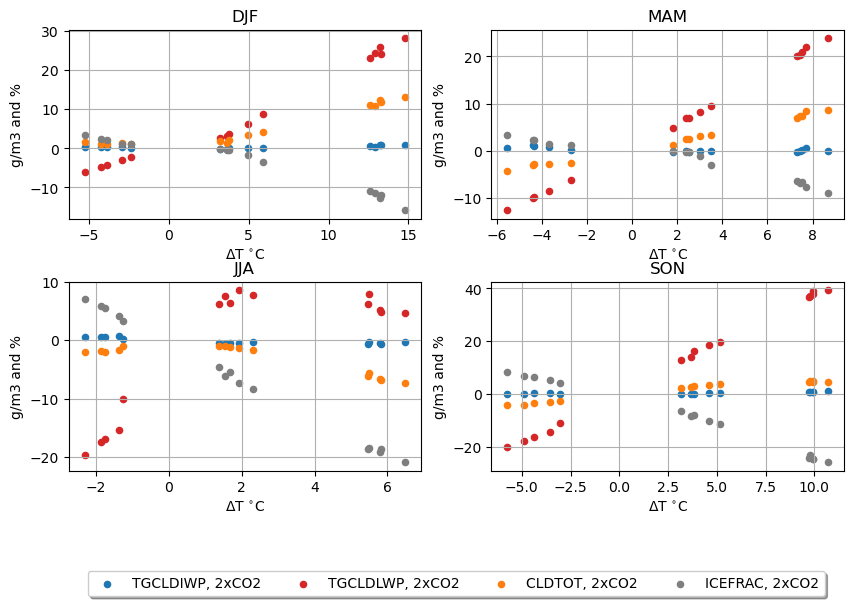

In [14]:
Arctic_limit = 60
seasons = ['DJF', 'MAM', 'JJA', 'SON']
variables = ['TGCLDIWP','TGCLDLWP', 'CLDTOT', 'ICEFRAC']
var_colors = ['tab:blue', 'tab:red', 'tab:orange', 'tab:gray']
exp_linestyles = ['-', '--', '-.']

piClim_Arctic = functions.computeWeightedMean(piClim_cloud.sel(lat=slice(Arctic_limit,90)))
ds_Arctic = functions.computeWeightedMean(ds.sel(lat=slice(Arctic_limit,90)))
ds_dT_Arctic = functions.computeWeightedMean(ds_dT.sel(lat=slice(Arctic_limit,90)))

fig, axs = plt.subplots(2, 2, figsize=[10,6])
for season, ax in zip(seasons, axs.flat):
    ds_Arctic_s = functions.computeSeasonalMean(ds_Arctic, season=season)
    piClim_Arctic_s = functions.computeSeasonalMean(piClim_Arctic, season=season)
    ds_dT_Arctic_s = functions.computeSeasonalMean(ds_dT_Arctic, season=season)
    for j, var in enumerate(variables):
        for i, co2_conc in enumerate(ds_Arctic_s.co2_conc.values):
            if season==seasons[-1] and co2_conc=='2xCO2':
                # add label
                if var == 'TGCLDLWP' or var == 'TGCLDIWP':
                    # Change unit to g/m3
                    ax.scatter(ds_dT_Arctic_s['tas'].sel(co2_conc=co2_conc), 
                            (ds_Arctic_s[var].sel(co2_conc=co2_conc)-piClim_Arctic_s[var])*1000, 
                            color=var_colors[j], label=var+', '+co2_conc, s=20)
                elif var == 'CLDTOT' or var=='ICEFRAC':
                    # Change unit to %
                    ax.scatter(ds_dT_Arctic_s['tas'].sel(co2_conc=co2_conc), 
                            (ds_Arctic_s[var].sel(co2_conc=co2_conc)-piClim_Arctic_s[var])*100, 
                            color=var_colors[j], label=var+', '+co2_conc, s=20)
            else:
                if var == 'TGCLDLWP' or var == 'TGCLDIWP':
                    # Change unit to g/m3
                    ax.scatter(ds_dT_Arctic_s['tas'].sel(co2_conc=co2_conc), 
                            (ds_Arctic_s[var].sel(co2_conc=co2_conc)-piClim_Arctic_s[var])*1000, 
                            color=var_colors[j], s=20)
                elif var == 'CLDTOT' or var=='ICEFRAC':
                    # Change unit to %
                    ax.scatter(ds_dT_Arctic_s['tas'].sel(co2_conc=co2_conc), 
                            (ds_Arctic_s[var].sel(co2_conc=co2_conc)-piClim_Arctic_s[var])*100, 
                            color=var_colors[j], s=20)

    
    #ax.set_ylim([-5, 5])
    ax.set_title(season)
    ax.grid()
    ax.set_xlabel('$\Delta$T $^{\circ}$C')
    ax.set_ylabel('g/m3 and %')

    # Shrink box size to make room for legend
    box = ax.get_position()
    ax.set_position([box.x0, box.y0 + box.height * 0.1,
                box.width, box.height * 0.9])

# Put a legend below last axis
ax.legend(loc='lower center', bbox_to_anchor=(-0.1, -0.7),
          fancybox=True, shadow=True, ncol=4)

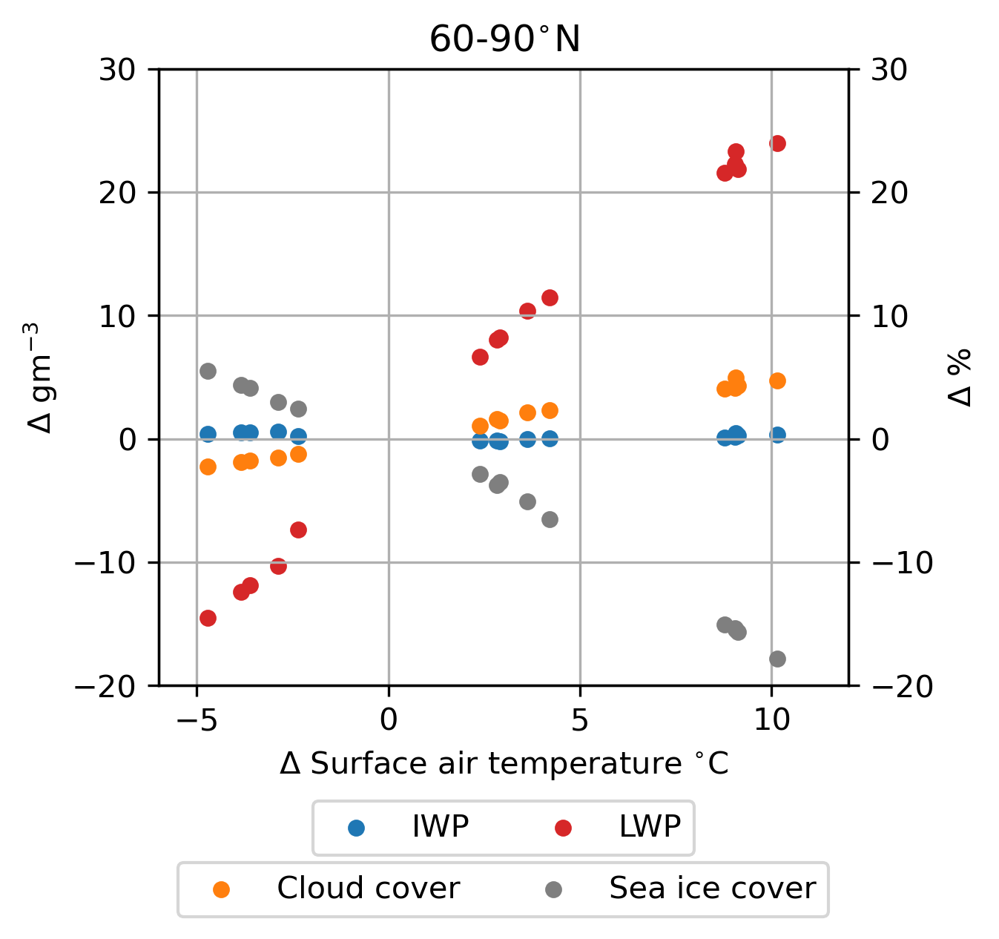

In [18]:
Arctic_limit = 60
seasons = ['DJF', 'MAM', 'JJA', 'SON']
variables = ['TGCLDIWP','TGCLDLWP', 'CLDTOT', 'ICEFRAC']
var_colors = ['tab:blue', 'tab:red', 'tab:orange', 'tab:gray']
var_labels = ['IWP', 'LWP', 'Cloud cover', 'Sea ice cover']
piClim_Arctic = functions.computeWeightedMean(piClim_cloud.sel(lat=slice(Arctic_limit,90))).mean('time')
ds_Arctic = functions.computeWeightedMean(ds.sel(lat=slice(Arctic_limit,90))).mean('time')
ds_dT_Arctic = functions.computeWeightedMean(ds_dT.sel(lat=slice(Arctic_limit,90))).mean('time')

fig, ax = plt.subplots(1, 1, figsize=[4,4], dpi=300)
ax2 = ax.twinx()

for j, var in enumerate(variables):
    for i, co2_conc in enumerate(ds_Arctic.co2_conc.values):
        if season==seasons[-1] and co2_conc=='2xCO2':
            # add label
            if var == 'TGCLDLWP' or var == 'TGCLDIWP':
                # Change unit to g/m3
                ax.scatter(ds_dT_Arctic['tas'].sel(co2_conc=co2_conc), 
                        (ds_Arctic[var].sel(co2_conc=co2_conc)-piClim_Arctic[var])*1000, 
                        color=var_colors[j], label=var_labels[j], s=20)
            elif var == 'CLDTOT' or var=='ICEFRAC':
                # Change unit to %
                ax2.scatter(ds_dT_Arctic['tas'].sel(co2_conc=co2_conc), 
                        (ds_Arctic[var].sel(co2_conc=co2_conc)-piClim_Arctic[var])*100, 
                        color=var_colors[j], label=var_labels[j], s=20)
        else:
            if var == 'TGCLDLWP' or var == 'TGCLDIWP':
                # Change unit to g/m3
                ax.scatter(ds_dT_Arctic['tas'].sel(co2_conc=co2_conc), 
                        (ds_Arctic[var].sel(co2_conc=co2_conc)-piClim_Arctic[var])*1000, 
                        color=var_colors[j], s=20)
            elif var == 'CLDTOT' or var=='ICEFRAC':
                # Change unit to %
                ax2.scatter(ds_dT_Arctic['tas'].sel(co2_conc=co2_conc), 
                        (ds_Arctic[var].sel(co2_conc=co2_conc)-piClim_Arctic[var])*100, 
                        color=var_colors[j], s=20)


ylim = [-20, 30]; xlim = [-6, 12] # Arctic
#ylim = [-5, 5]; xlim = [-2, 5]  # Global
ax.set_title(str(Arctic_limit)+'-90$^{\circ}$N')
ax.grid()
ax.set_xlabel('$\Delta$ Surface air temperature $^{\circ}$C')
ax.set_ylabel('$\Delta$ gm$^{-3}$')
ax2.set_ylabel('$\Delta$ %')
ax.set_ylim(ylim)
ax2.set_ylim(ylim)
ax.set_xlim(xlim)

# Shrink box size to make room for legend
box = ax.get_position()
ax.set_position([box.x0, box.y0 + box.height * 0.1,
            box.width, box.height * 0.9])

# Put a legend below last axis
ax.legend(loc='lower center', bbox_to_anchor=(0.5, -0.3), ncol=2)
ax2.legend(loc='lower center', bbox_to_anchor=(0.5, -0.4), ncol=2)

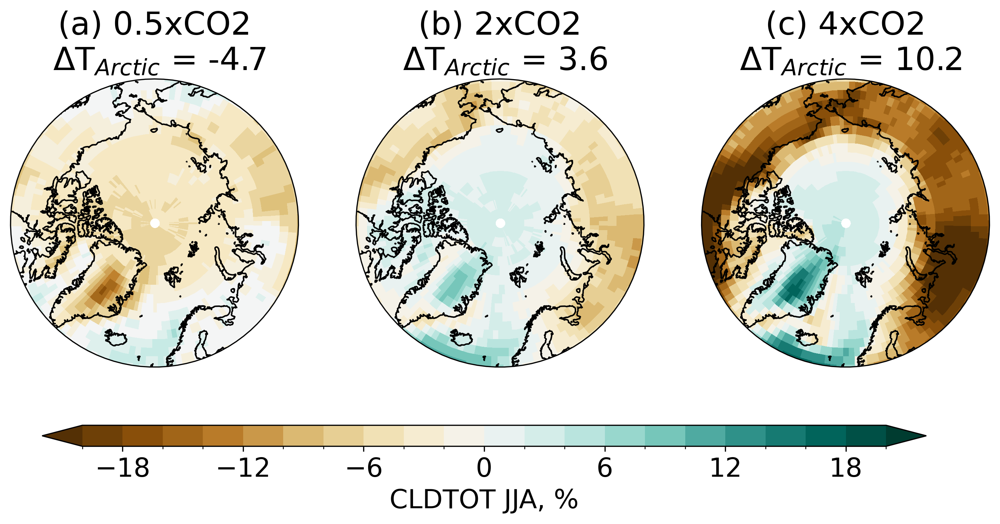

<Figure size 640x480 with 0 Axes>

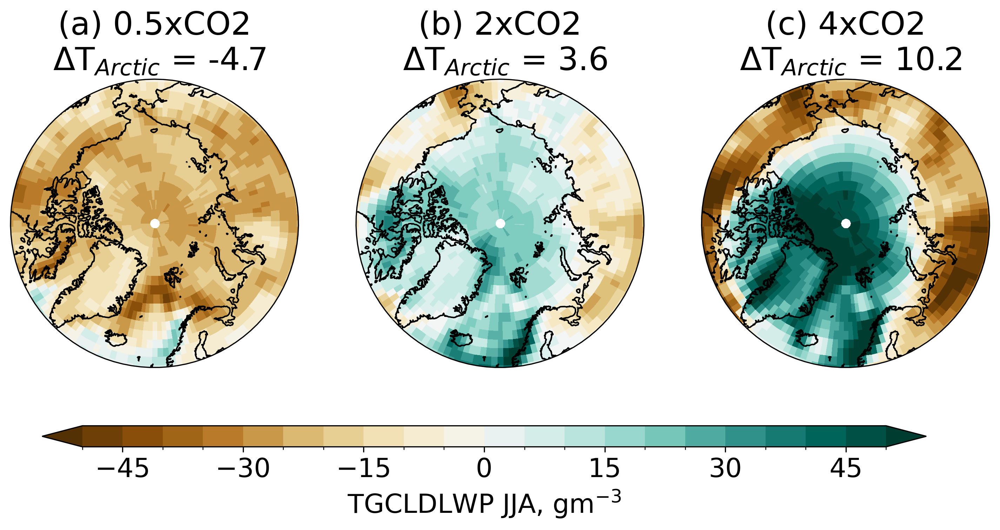

<Figure size 640x480 with 0 Axes>

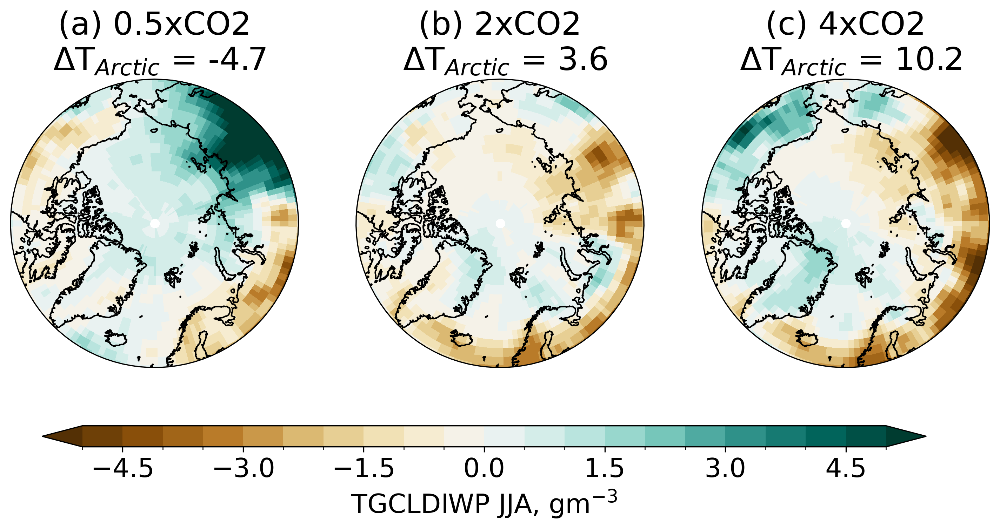

<Figure size 640x480 with 0 Axes>

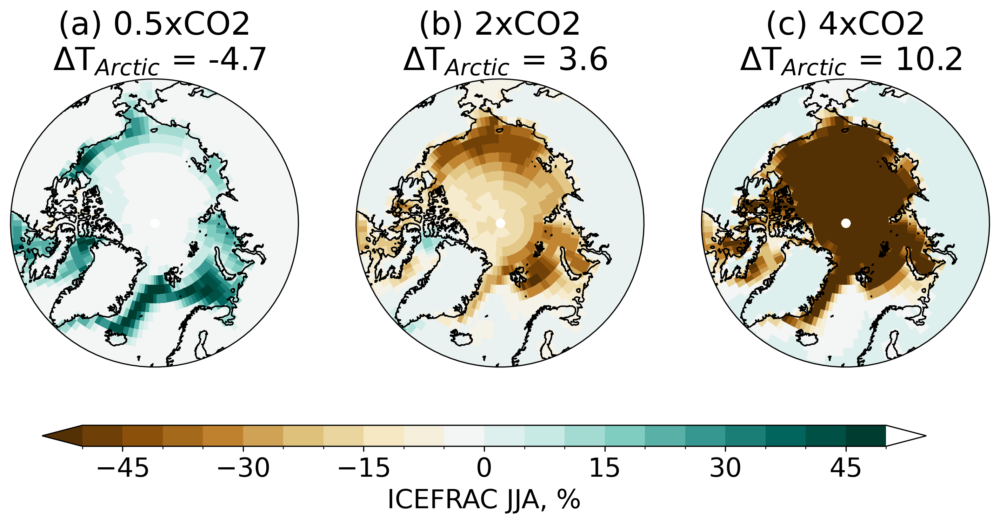

<Figure size 640x480 with 0 Axes>

In [5]:
Arctic_limit = 60
#ds_mean = ds.mean('time')
ds_mean = functions.computeSeasonalMean(ds, season='JJA')
#piClim_mean = piClim_cloud.mean('time')
piClim_mean = functions.computeSeasonalMean(piClim_cloud, season='JJA')
ds_dT_Arctic = functions.computeWeightedMean(ds_dT.sel(lat=slice(Arctic_limit,90)))
variables = ['CLDTOT', 'TGCLDLWP', 'TGCLDIWP', 'ICEFRAC']
units = ['%', 'gm$^{-3}$', 'gm$^{-3}$', '%']
limits = [20, 50, 5, 50]
period = 120

import cartopy.crs as ccrs

for var, unit, lim in zip(variables, units, limits):
    fig = plt.figure(figsize=[12, 5],dpi=300)
    # Set the projection to use for plotting
    ax1 = plt.subplot(1, 3, 1, projection=ccrs.Orthographic(0, 90))
    ax2 = plt.subplot(1, 3, 2, projection=ccrs.Orthographic(0, 90))
    ax3 = plt.subplot(1, 3, 3, projection=ccrs.Orthographic(0, 90))
    #plt.subplots_adjust(top=0.85)

    for ax,co2_conc,label in zip([ax1, ax2, ax3], ['0.5xCO2', '2xCO2', '4xCO2'], ["(a)", "(b)", "(c)"]):
        
        functions.polarCentral_set_latlim([60,90], ax)
        data = ds_mean[var].sel(period=period, co2_conc=co2_conc) - piClim_mean[var]
        if var == 'TGCLDLWP' or var == 'TGCLDIWP':
            data = data*1000
        elif var == 'CLDTOT' or var == 'ICEFRAC':
            data = data*100
        map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                            cmap='BrBG', 
                                            levels=np.linspace(-lim, lim, 21),
                                            add_colorbar=False)
        deltaT = np.round(ds_dT_Arctic['tas'].sel(period=period, co2_conc=co2_conc).mean('time').values, 1)
        ax.set_title(label+" "+co2_conc+'\n $\Delta$T$_{Arctic}$ = '+str(deltaT), fontsize=22)
        ax.coastlines()


    cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

    cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
    cbar.ax.tick_params(labelsize=18)
    cbar.ax.set_xlabel(var+' JJA, '+unit, fontsize=18)
    plt.show()
    #plt.savefig('../figures/annavg_'+var+'_'+str(period)+'.png')
    plt.clf()

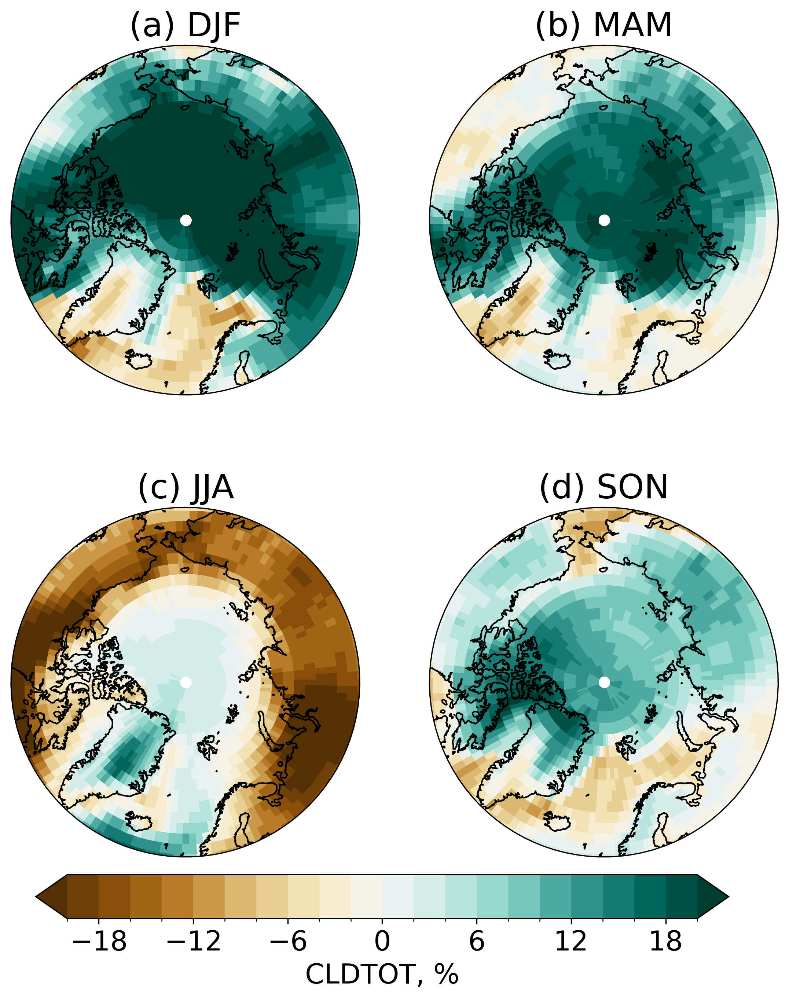

<Figure size 640x480 with 0 Axes>

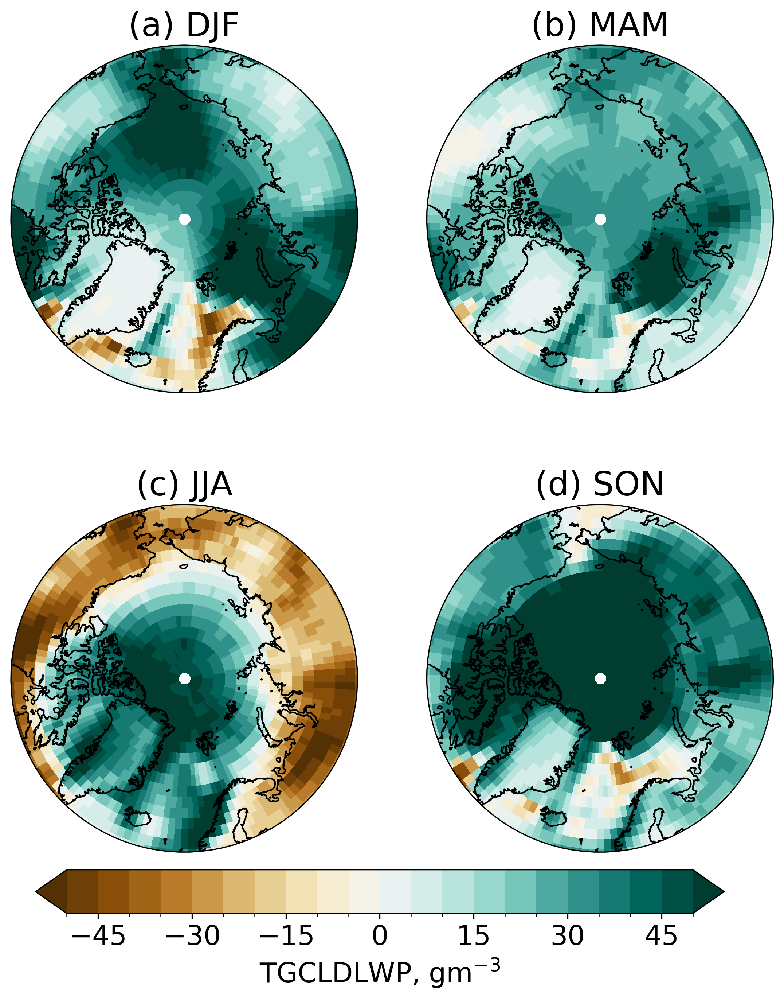

<Figure size 640x480 with 0 Axes>

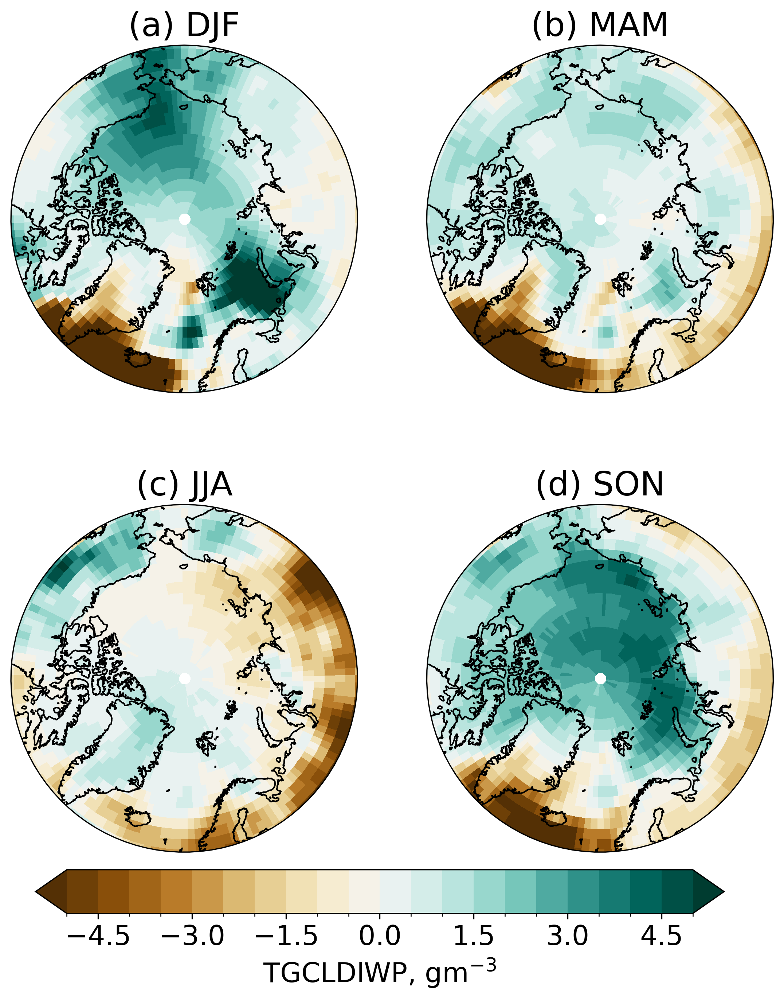

<Figure size 640x480 with 0 Axes>

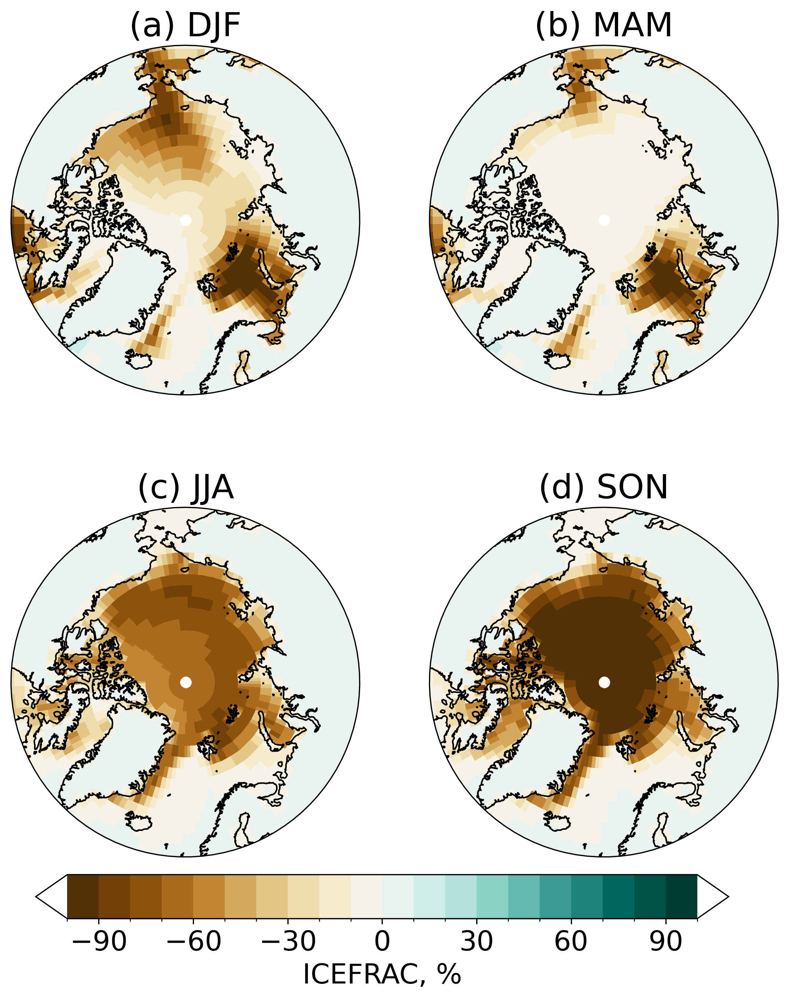

<Figure size 640x480 with 0 Axes>

In [29]:
Arctic_limit = 60
ds_dT_Arctic = functions.computeWeightedMean(ds_dT.sel(lat=slice(Arctic_limit,90)))
variables = ['CLDTOT', 'TGCLDLWP', 'TGCLDIWP', 'ICEFRAC']
units = ['%', 'gm$^{-3}$', 'gm$^{-3}$', '%']
limits = [20, 50, 5, 100]
period = 120
co2_conc = '4xCO2'

import cartopy.crs as ccrs
for var, unit, lim in zip(variables, units, limits):
    fig = plt.figure(figsize=[9, 10],dpi=300)

    # Set the projection to use for plotting
    ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
    ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
    ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
    ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))

    for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):
        piClim_s = functions.computeSeasonalMean(piClim_cloud, season=season)
        ds_s = functions.computeSeasonalMean(ds, season=season)

        functions.polarCentral_set_latlim([60,90], ax)
        data = ds_s[var].sel(period=period, co2_conc=co2_conc) - piClim_s[var]
        if var == 'TGCLDLWP' or var == 'TGCLDIWP':
            data = data*1000
        elif var == 'CLDTOT' or var == 'ICEFRAC':
            data = data*100
        map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                            cmap='BrBG', 
                                            levels=np.linspace(-lim, lim, 21),
                                            add_colorbar=False)
        ax.set_title(label+" "+season, fontsize=22)
        ax.coastlines()


    cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

    cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
    cbar.ax.tick_params(labelsize=18)
    cbar.ax.set_xlabel(var+', '+unit, fontsize=18)
    #plt.savefig('../figures/seasons_'+var+'_'+co2_conc+'_'+str(period)+'.png')
    plt.show()
    plt.clf()

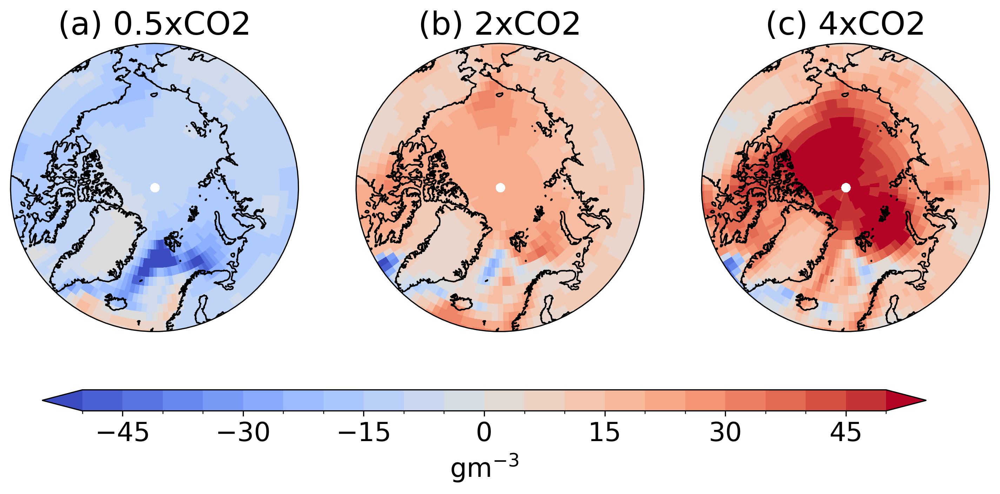

In [29]:
Arctic_limit = 60
ds_mean = ds.mean('time')
piClim_mean = piClim_cloud.mean('time')
ds_dT_Arctic = functions.computeWeightedMean(ds_dT.sel(lat=slice(Arctic_limit,90)))
variables = ['CLDTOT', 'TGCLDLWP', 'TGCLDIWP', 'ICEFRAC']
unit = 'gm$^{-3}$'
lim = 50
period = 120

import cartopy.crs as ccrs
fig = plt.figure(1, figsize=[12, 5],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(1, 3, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(1, 3, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(1, 3, 3, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

for ax,co2_conc,label in zip([ax1, ax2, ax3], ['0.5xCO2', '2xCO2', '4xCO2'], ["(a)", "(b)", "(c)"]):
    
    functions.polarCentral_set_latlim([60,90], ax)
    change1 = ds_mean['TGCLDLWP'].sel(period=period, co2_conc=co2_conc) - piClim_mean['TGCLDLWP'] 
    change2 = ds_mean['TGCLDIWP'].sel(period=period, co2_conc=co2_conc) - piClim_mean['TGCLDIWP']
    data = (change1 + change2)*1000
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='coolwarm', 
                                        levels=np.linspace(-lim, lim, 21),
                                        add_colorbar=False)
    ax.set_title(label+" "+co2_conc, fontsize=22)
    ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)
plt.show()

Text(0.5, 0, 'g/m3')

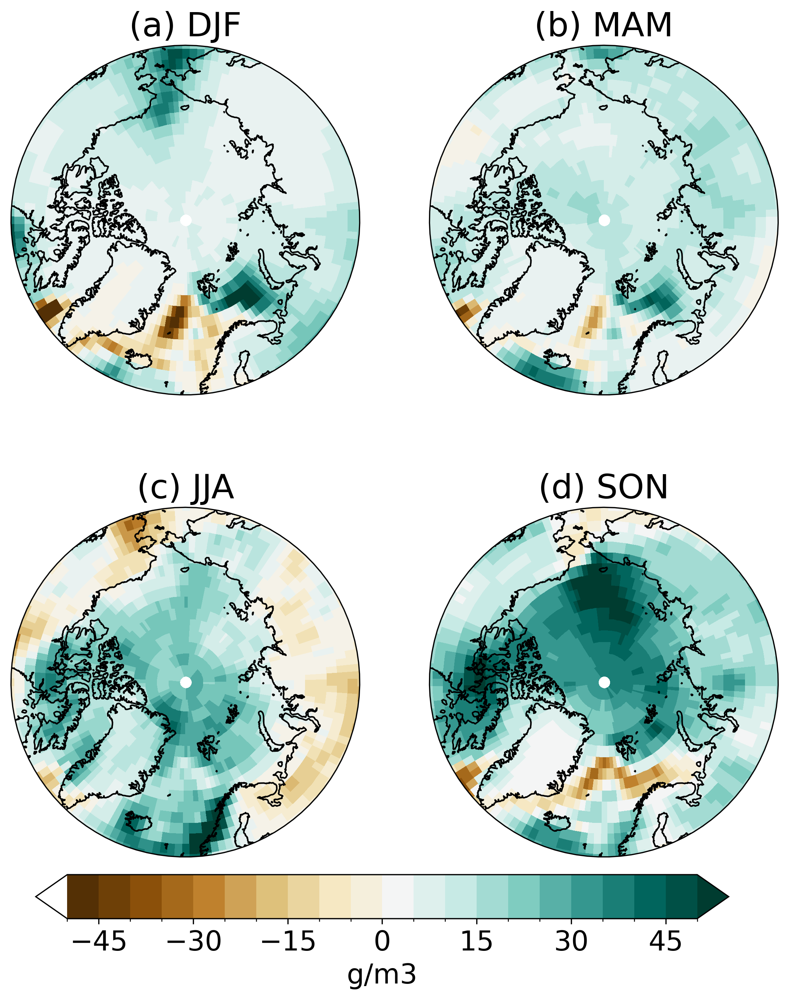

In [6]:
var = 'TGCLDLWP'
co2_conc = '2xCO2'
period=135
lim = 50
unit = 'g/m3'

import cartopy.crs as ccrs
fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):
    piClim_s = functions.computeSeasonalMean(piClim_cloud, season=season)
    ds_s = functions.computeSeasonalMean(ds, season=season)

    functions.polarCentral_set_latlim([60,90], ax)
    #change1 = ds_s['TGCLDLWP'].sel(period=period, co2_conc=co2_conc) - piClim_s['TGCLDLWP'] 
    #change2 = ds_s['TGCLDIWP'].sel(period=period, co2_conc=co2_conc) - piClim_s['TGCLDIWP']
    #data = (change1 + change2)*1000
    data = ds_s[var].sel(period=period, co2_conc=co2_conc) - piClim_s[var]
    data = data*1000
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='BrBG', levels=np.linspace(-lim, lim, 21),
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)


Text(0.5, 0, 'Total cloud fraction %')

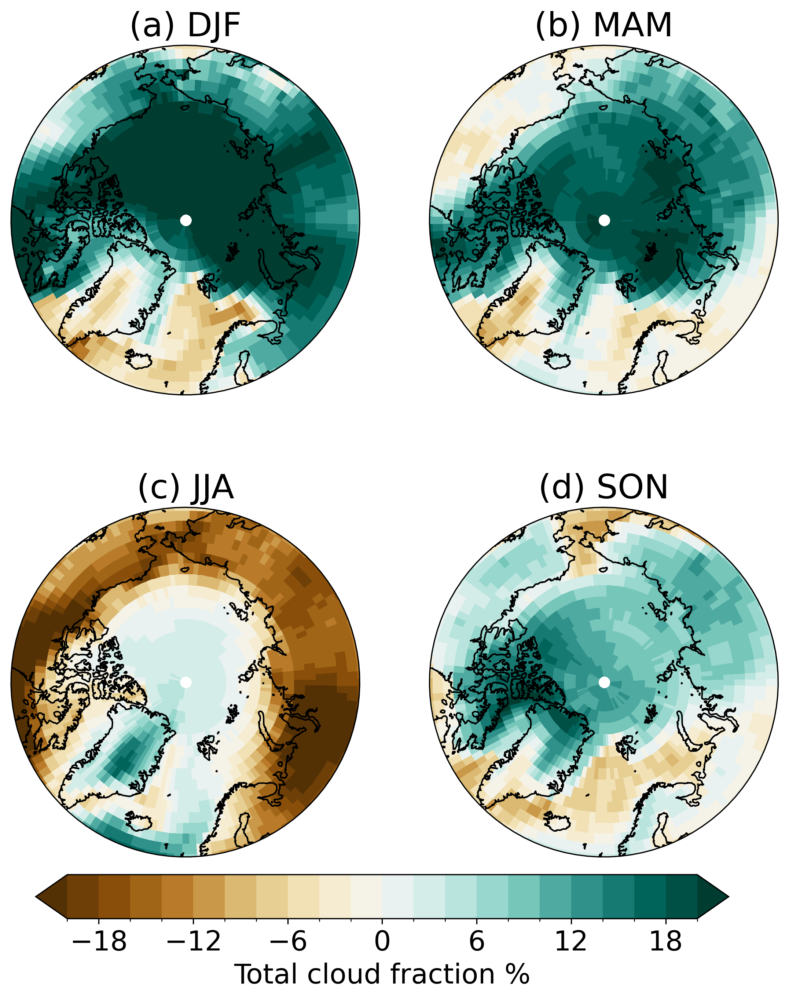

In [6]:
var = 'CLDTOT'
co2_conc = '4xCO2'
period=120
lim = 20
unit = 'Total cloud fraction %'

import cartopy.crs as ccrs
fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):
    piClim_s = functions.computeSeasonalMean(piClim_cloud, season=season)
    ds_s = functions.computeSeasonalMean(ds, season=season)

    functions.polarCentral_set_latlim([60,90], ax)
    data = ds_s[var].sel(period=period, co2_conc=co2_conc) - piClim_s[var] 
    data = data*100
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='BrBG', levels=np.linspace(-lim, lim, 21),
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)


[<GeoAxes: > <GeoAxes: > <GeoAxes: >]


Text(0.5, 0, 'Total cloud fraction %')

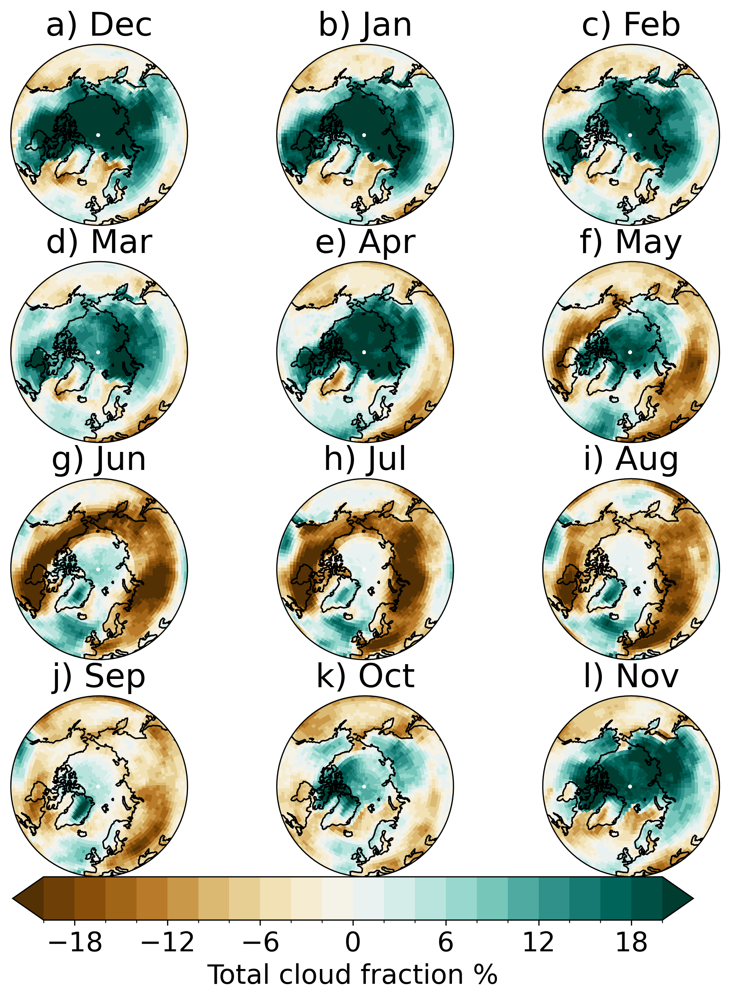

In [9]:
var = 'CLDTOT'
co2_conc = '4xCO2'
period=120
lim = 20
unit = 'Total cloud fraction %'

# Set the projection to use for plotting
fig,axs = plt.subplots(nrows=4, ncols=3, figsize=[9,10],dpi=300,  subplot_kw={'projection':ccrs.Orthographic(0, 90)})
print(axs[0,:])

months = [[12, 1, 2], 
        [3, 4, 5], 
        [6, 7, 8], 
        [9, 10, 11]]

month_names = [['Dec', 'Jan', 'Feb'], 
        ['Mar', 'Apr', 'May'], 
        ['Jun', 'Jul', 'Aug'], 
        ['Sep', 'Oct', 'Nov']]

labels = [['a)', 'b)', 'c)'], 
        ['d)', 'e)', 'f)'], 
        ['g)', 'h)', 'i)'], 
        ['j)', 'k)', 'l)']]

for row in range(4):
    for col in range(3):
        ax = axs[row][col]
        month = months[row][col]
        piClim_s = piClim_cloud.sel(time=month)
        ds_s = ds.sel(time=month)

        functions.polarCentral_set_latlim([40,90], ax)
        data = ds_s[var].sel(period=period, co2_conc=co2_conc) - piClim_s[var] 
        data = data*100
        map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                            cmap='BrBG', levels=np.linspace(-lim, lim, 21),
                                            add_colorbar=False)
        ax.set_title(labels[row][col]+' '+month_names[row][col], fontsize=22)
        #ax.set_title(label+" "+month, fontsize=22)

        ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)


Text(0.5, 0, '$\\Delta$ Surface temperature K')

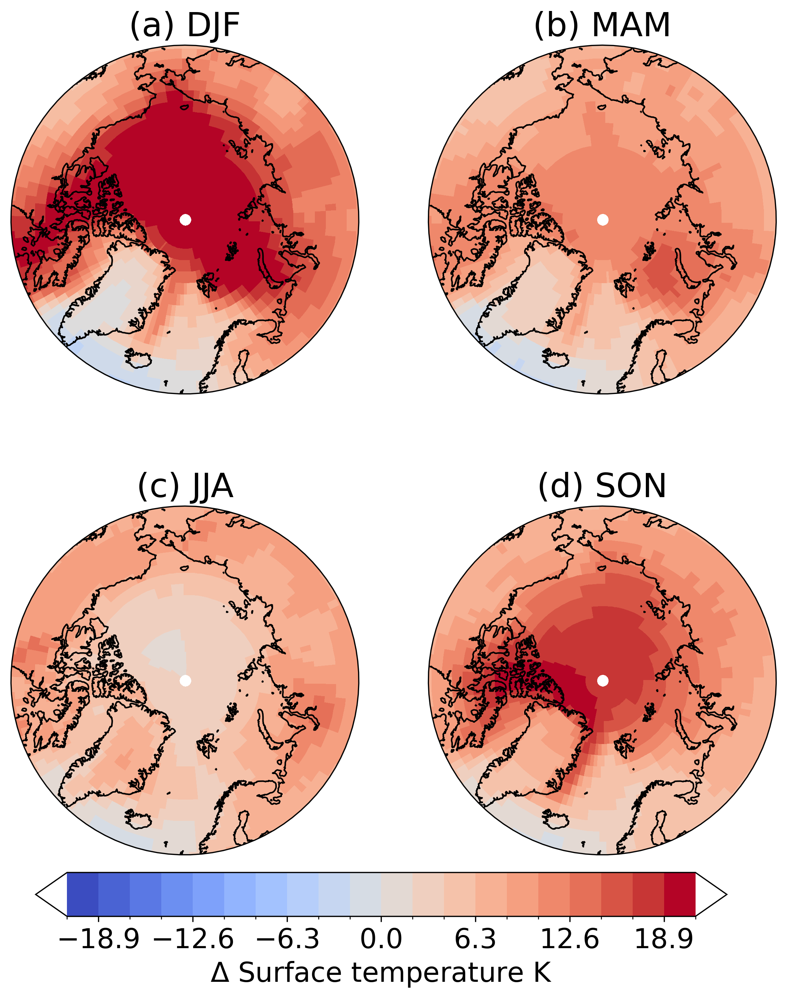

In [11]:
var = 'tas'
co2_conc = '4xCO2'
period=120
lim = 21
unit = '$\Delta$ Surface temperature K'

import cartopy.crs as ccrs
fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):
    #piClim_s = functions.computeSeasonalMean(piClim_cloud, season=season)
    ds_s = functions.computeSeasonalMean(ds_dT, season=season)

    functions.polarCentral_set_latlim([60,90], ax)
    data = ds_s[var].sel(period=period, co2_conc=co2_conc)# - piClim_s[var] 
    data = data
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='coolwarm', levels=np.linspace(-lim, lim, 21),
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)


In [39]:
# Precipitation

rpath = '/nird/datapeak/NS9600K/astridbg/arctic-cld-feedbacks/data/'
precip_piClim = xr.open_dataset(rpath+'N1850_f19_tn14_noresm2_3_slf_output_20250529.precip.cam.concatfiles.nc')
precip_2xCO2 = xr.open_dataset(rpath+'N1850_f19_tn14_noresm2_3_slf_output_2xCO2_20250529.precip.cam.concatfiles.nc')
precip_4xCO2 = xr.open_dataset(rpath+'N1850_f19_tn14_noresm2_3_slf_output_4xCO2_20250529.precip.cam.concatfiles.nc')

# Fix time stamp
precip_piClim = functions.fix_cam_time(precip_piClim)
precip_2xCO2 = functions.fix_cam_time(precip_2xCO2)
precip_4xCO2 = functions.fix_cam_time(precip_4xCO2)

Text(0.5, 0, 'mm/day')

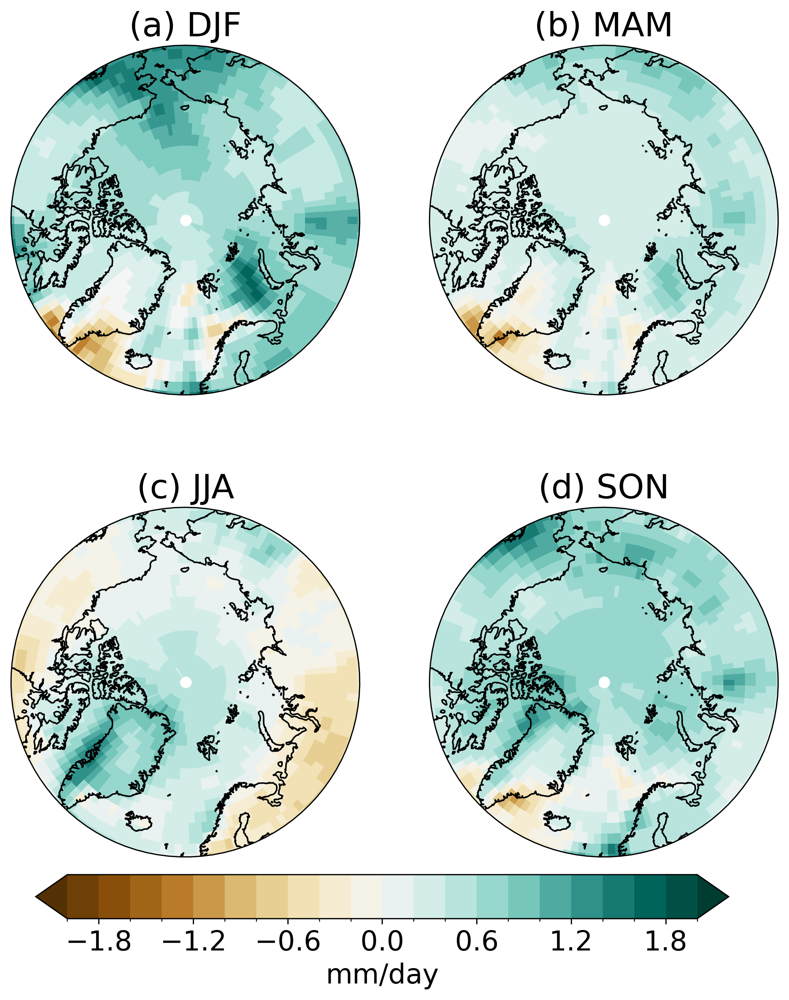

In [ ]:
# PLOT PRECIPITATION CHANGE
var = 'PRECL'
tslice = slice('2040-01-01', '2069-12-31')
precip_slice_piClim = precip_piClim.sel(time=tslice)
precip_slice_4xCO2 = precip_4xCO2.sel(time=tslice)
lim = 2
levels = np.linspace(-lim, lim, 21)
unit = 'mm/day'

precip_piClim_season = precip_slice_piClim.groupby(precip_slice_piClim.time.dt.season).mean('time')
precip_4xCO2_season = precip_slice_4xCO2.groupby(precip_slice_4xCO2.time.dt.season).mean('time')

fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):

    functions.polarCentral_set_latlim([60,90], ax)
    data = precip_4xCO2_season[var].sel(season=season) - precip_piClim_season[var].sel(season=season)
    data = data*1000*60*60*24
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='BrBG', levels=levels,
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)


Text(0.5, 0, 'Convective, mm/day')

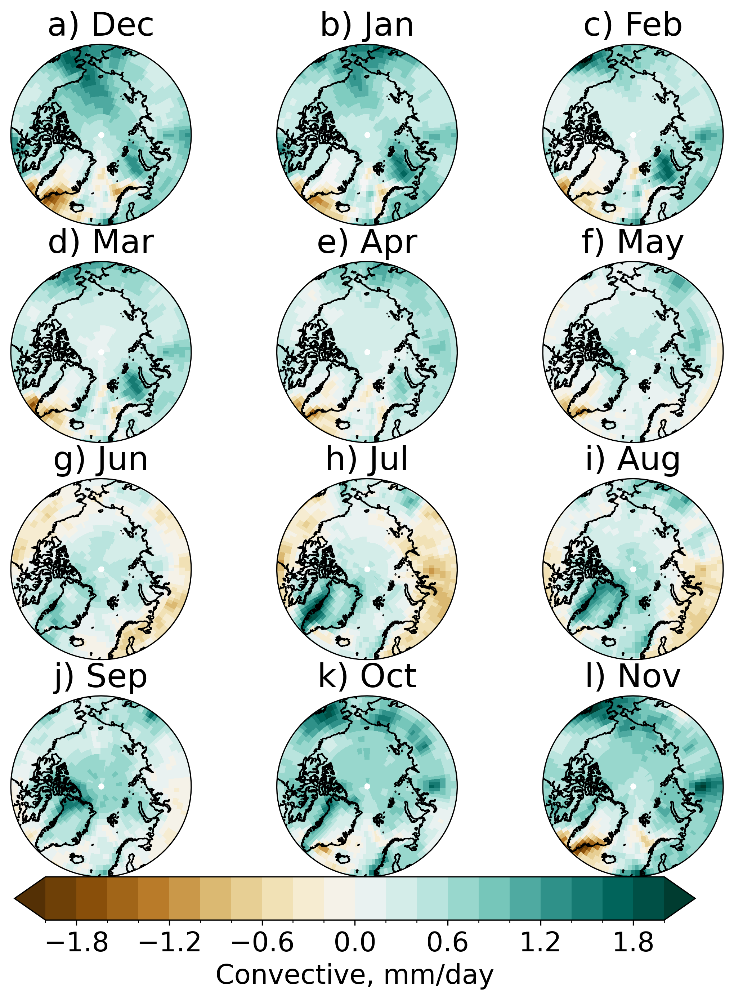

In [ ]:
# PLOT PRECIPITATION CHANGE
var = 'PRECL'
tslice = slice('2040-01-01', '2069-12-31')
precip_slice_piClim = precip_piClim.sel(time=tslice)
precip_slice_4xCO2 = precip_4xCO2.sel(time=tslice)
lim = 2
levels = np.linspace(-lim, lim, 21)
unit = 'mm/day'

precip_piClim_monthly = precip_slice_piClim.groupby(precip_slice_piClim.time.dt.month).mean('time')
precip_4xCO2_monthly = precip_slice_4xCO2.groupby(precip_slice_4xCO2.time.dt.month).mean('time')


# Set the projection to use for plotting
fig,axs = plt.subplots(nrows=4, ncols=3, figsize=[9,10],dpi=300,  subplot_kw={'projection':ccrs.Orthographic(0, 90)})

months = [[12, 1, 2], 
        [3, 4, 5], 
        [6, 7, 8], 
        [9, 10, 11]]

month_names = [['Dec', 'Jan', 'Feb'], 
        ['Mar', 'Apr', 'May'], 
        ['Jun', 'Jul', 'Aug'], 
        ['Sep', 'Oct', 'Nov']]

labels = [['a)', 'b)', 'c)'], 
        ['d)', 'e)', 'f)'], 
        ['g)', 'h)', 'i)'], 
        ['j)', 'k)', 'l)']]

for row in range(4):
    for col in range(3):
        ax = axs[row][col]
        month = months[row][col]
        piClim_i = precip_piClim_monthly.sel(month=month)
        ds_i = precip_4xCO2_monthly.sel(month=month)

        functions.polarCentral_set_latlim([60,90], ax)
        data = ds_i[var] - piClim_i[var] 
        data = data*1000*60*60*24
        map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                            cmap='BrBG', levels=np.linspace(-lim, lim, 21),
                                            add_colorbar=False)
        ax.set_title(labels[row][col]+' '+month_names[row][col], fontsize=22)
        #ax.set_title(label+" "+month, fontsize=22)

        ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
#cbar.ax.set_xlabel(unit, fontsize=18)
cbar.ax.set_xlabel('Convective, '+unit, fontsize=18)
cbar.ax.set_xlabel('Large-scale, '+unit, fontsize=18)

Text(0.5, 0, 'Surface latent heat flux')

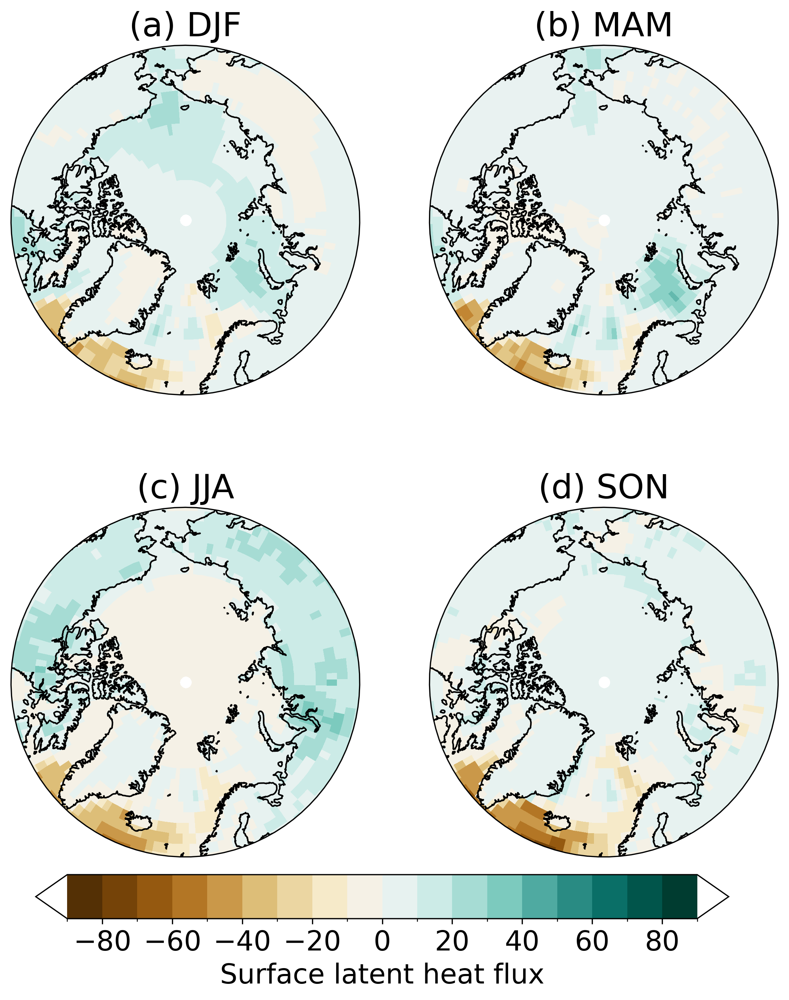

In [47]:
var = 'LHFLX'
co2_conc = '4xCO2'
period=120
lim = 20
levels = np.linspace(-lim, lim, 21)
levels = 21
unit = 'Surface latent heat flux'

import cartopy.crs as ccrs
fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):
    piClim_s = functions.computeSeasonalMean(piClim_cloud, season=season)
    ds_s = functions.computeSeasonalMean(ds, season=season)

    functions.polarCentral_set_latlim([60,90], ax)
    data = ds_s[var].sel(period=period, co2_conc=co2_conc) - piClim_s[var] 
    data = data
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='BrBG', levels=levels,
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)

In [19]:
rpath = '/nird/datapeak/NS9600K/astridbg/arctic-cld-feedbacks/data/'
ds_piClim_xtra = xr.open_dataset(rpath+'N1850_f19_tn14_noresm2_3_slf_output_20250529.energy.cam.concatfiles.nc')
ds_2xCO2_xtra = xr.open_dataset(rpath+'N1850_f19_tn14_noresm2_3_slf_output_2xCO2_20250529.energy.cam.concatfiles.nc')
ds_4xCO2_xtra = xr.open_dataset(rpath+'N1850_f19_tn14_noresm2_3_slf_output_4xCO2_20250529.energy.cam.concatfiles.nc')

# Fix time stamp
#ds_piClim_xtra = functions.fix_cam_time(ds_piClim_xtra)
#ds_2xCO2_xtra = functions.fix_cam_time(ds_2xCO2_xtra)
#ds_4xCO2_xtra = functions.fix_cam_time(ds_4xCO2_xtra)
print(ds_piClim_xtra.time[0])

rpath = '/nird/datapeak/NS9600K/astridbg/arctic-cld-feedbacks/data/other_cloud_vars/'
LHFLX_piClim = xr.open_dataset(rpath+'LHFLX_piClim.nc')
LHFLX_2xCO2 = xr.open_dataset(rpath+'LHFLX_abrupt-2xCO2.nc')
LHFLX_4xCO2 = xr.open_dataset(rpath+'LHFLX_abrupt-4xCO2.nc')
print(LHFLX_piClim.time[0])

energy_piClim = xr.merge([ds_piClim_xtra, LHFLX_piClim])
energy_2xCO2 = xr.merge([ds_2xCO2_xtra, LHFLX_2xCO2])
energy_4xCO2 = xr.merge([ds_4xCO2_xtra, LHFLX_4xCO2])

# Fix time stamp
energy_piClim = functions.fix_cam_time(energy_piClim)
energy_2xCO2 = functions.fix_cam_time(energy_2xCO2)
energy_4xCO2 = functions.fix_cam_time(energy_4xCO2)
print(energy_piClim.time[0])


# Calculate evaporative fraction
energy_piClim['BOWEN_RATIO'] = energy_piClim['SHFLX']/energy_piClim['LHFLX']
energy_piClim['EF'] = energy_piClim['LHFLX']/(energy_piClim['LHFLX'] + energy_piClim['SHFLX'])
#energy_piClim['EF'] = abs(energy_piClim['LHFLX'])/(abs(energy_piClim['LHFLX']) + abs(energy_piClim['SHFLX']))
energy_piClim['EF_abs'] = abs(energy_piClim['LHFLX'])/abs(energy_piClim['LHFLX'] + energy_piClim['SHFLX'])


energy_2xCO2['BOWEN_RATIO'] = energy_2xCO2['SHFLX']/energy_2xCO2['LHFLX']
#energy_2xCO2['EF'] = abs(energy_2xCO2['LHFLX'])/(abs(energy_2xCO2['LHFLX']) + abs(energy_2xCO2['SHFLX']))
energy_2xCO2['EF_abs'] = abs(energy_2xCO2['LHFLX'])/abs(energy_2xCO2['LHFLX'] + energy_2xCO2['SHFLX'])
energy_2xCO2['EF'] = energy_2xCO2['LHFLX']/(energy_2xCO2['LHFLX'] + energy_2xCO2['SHFLX'])

energy_4xCO2['BOWEN_RATIO'] = energy_4xCO2['SHFLX']/energy_4xCO2['LHFLX']
energy_4xCO2['EF'] = energy_4xCO2['LHFLX']/(energy_4xCO2['LHFLX'] + energy_4xCO2['SHFLX'])
#energy_4xCO2['EF'] = abs(energy_4xCO2['LHFLX'])/(abs(energy_4xCO2['LHFLX']) + abs(energy_4xCO2['SHFLX']))
energy_4xCO2['EF_abs'] = abs(energy_4xCO2['LHFLX'])/abs(energy_4xCO2['LHFLX'] + energy_4xCO2['SHFLX'])


<xarray.DataArray 'time' ()> Size: 8B
array(cftime.DatetimeNoLeap(1920, 2, 1, 0, 0, 0, 0, has_year_zero=True),
      dtype=object)
Coordinates:
    time     object 8B 1920-02-01 00:00:00
Attributes:
    long_name:     time
    bounds:        time_bnds
    cell_methods:  time: mean
<xarray.DataArray 'time' ()> Size: 8B
array(cftime.DatetimeNoLeap(1920, 2, 1, 0, 0, 0, 0, has_year_zero=True),
      dtype=object)
Coordinates:
    time     object 8B 1920-02-01 00:00:00
Attributes:
    long_name:     time
    bounds:        time_bnds
    cell_methods:  time: mean
<xarray.DataArray 'time' ()> Size: 8B
array(cftime.DatetimeNoLeap(1920, 1, 15, 0, 0, 0, 0, has_year_zero=True),
      dtype=object)
Coordinates:
    time     object 8B 1920-01-15 00:00:00


<xarray.DataArray 'SHFLX' (time: 1800, lat: 96, lon: 144)> Size: 100MB
[24883200 values with dtype=float32]
Coordinates:
  * lat      (lat) float64 768B -90.0 -88.11 -86.21 -84.32 ... 86.21 88.11 90.0
  * lon      (lon) float64 1kB 0.0 2.5 5.0 7.5 10.0 ... 350.0 352.5 355.0 357.5
  * time     (time) object 14kB 1920-01-15 00:00:00 ... 2069-12-15 00:00:00
Attributes:
    units:         W/m2
    long_name:     Surface sensible heat flux
    cell_methods:  time: mean

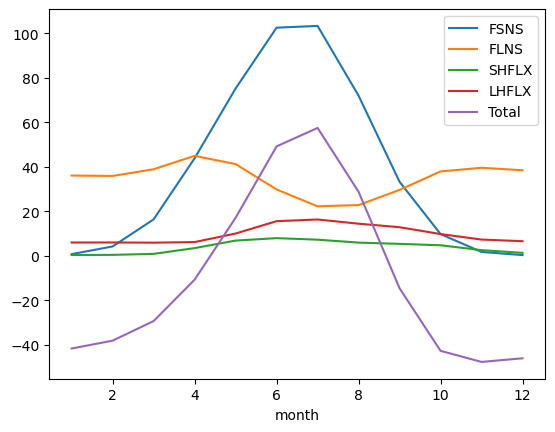

In [41]:
FSNS_mean = energy_piClim['FSNS'].sel(lat=slice(60,90)).mean(['lat', 'lon']).groupby('time.month').mean('time')
FLNS_mean = energy_piClim['FLNS'].sel(lat=slice(60,90)).mean(['lat', 'lon']).groupby('time.month').mean('time')
SHFLX_mean = energy_piClim['SHFLX'].sel(lat=slice(60,90)).mean(['lat', 'lon']).groupby('time.month').mean('time')
LHFLX_mean = energy_piClim['LHFLX'].sel(lat=slice(60,90)).mean(['lat', 'lon']).groupby('time.month').mean('time')


energy_piClim['FSNS'].sel(lat=slice(60,90)).mean(['lat', 'lon']).groupby('time.month').mean('time').plot(label='FSNS')
energy_piClim['FLNS'].sel(lat=slice(60,90)).mean(['lat', 'lon']).groupby('time.month').mean('time').plot(label='FLNS')
energy_piClim['SHFLX'].sel(lat=slice(60,90)).mean(['lat', 'lon']).groupby('time.month').mean('time').plot(label='SHFLX')
energy_piClim['LHFLX'].sel(lat=slice(60,90)).mean(['lat', 'lon']).groupby('time.month').mean('time').plot(label='LHFLX')
(FSNS_mean - FLNS_mean - SHFLX_mean - LHFLX_mean).plot(label='Total')
plt.legend()

energy_piClim['SHFLX']

Text(0.5, 0, 'Evaporative fraction')

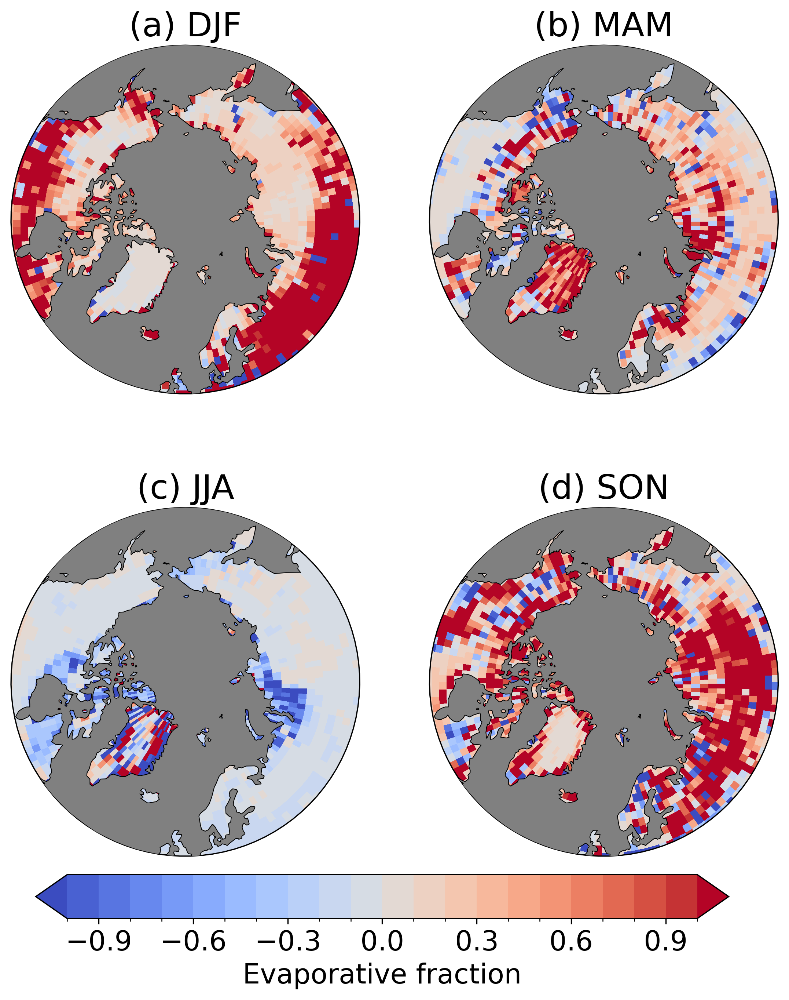

In [24]:
# PLOT EVAPORATIVE FRACTION
var = 'EF_abs'
tslice = slice('2040-01-01', '2069-12-31')
energy_slice_piClim = energy_piClim.sel(time=tslice)
energy_slice_2xCO2 = energy_2xCO2.sel(time=tslice)
energy_slice_4xCO2 = energy_4xCO2.sel(time=tslice)
lim = 1
levels = np.linspace(-lim, lim, 21)
unit = 'Evaporative fraction'

energy_piClim_season = energy_slice_piClim.groupby(energy_slice_piClim.time.dt.season).mean('time',skipna=True)
energy_2xCO2_season = energy_slice_2xCO2.groupby(energy_slice_2xCO2.time.dt.season).mean('time',skipna=True)
energy_4xCO2_season = energy_slice_4xCO2.groupby(energy_slice_4xCO2.time.dt.season).mean('time',skipna=True)


fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

import cartopy
for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):

    functions.polarCentral_set_latlim([50,90], ax)
    data = energy_4xCO2_season[var].sel(season=season) - energy_piClim_season[var].sel(season=season)
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='coolwarm', levels=levels,
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()
    ax.add_feature(cartopy.feature.OCEAN, zorder=100,facecolor='grey')


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)

Text(0.5, 0, 'Evaporative fraction')

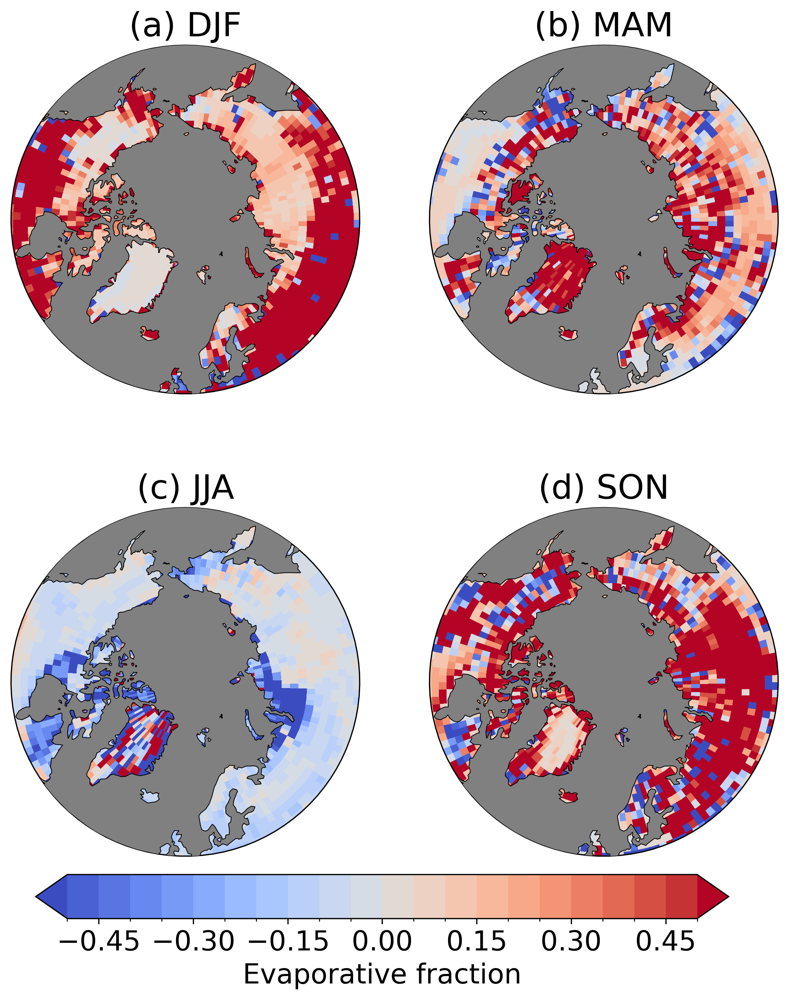

In [63]:
# PLOT BOWEN RATIO
var = 'EF_abs'
tslice = slice('2040-01-01', '2069-12-31')
energy_slice_piClim = energy_piClim.sel(time=tslice)
energy_slice_2xCO2 = energy_2xCO2.sel(time=tslice)
energy_slice_4xCO2 = energy_4xCO2.sel(time=tslice)
lim = 0.5
levels = np.linspace(-lim, lim, 21)
#unit = 'Bowen ratio'
unit = 'Evaporative fraction'

energy_piClim_season = energy_slice_piClim.groupby(energy_slice_piClim.time.dt.season).mean('time',skipna=True)
energy_2xCO2_season = energy_slice_2xCO2.groupby(energy_slice_2xCO2.time.dt.season).mean('time',skipna=True)
energy_4xCO2_season = energy_slice_4xCO2.groupby(energy_slice_4xCO2.time.dt.season).mean('time',skipna=True)


fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

import cartopy
for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):

    functions.polarCentral_set_latlim([50,90], ax)
    data = energy_4xCO2_season[var].sel(season=season) - energy_piClim_season[var].sel(season=season)
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='coolwarm', levels=levels,
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()
    ax.add_feature(cartopy.feature.OCEAN, zorder=100,facecolor='grey')


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)

Text(0.5, 0, 'Bowen ratio')

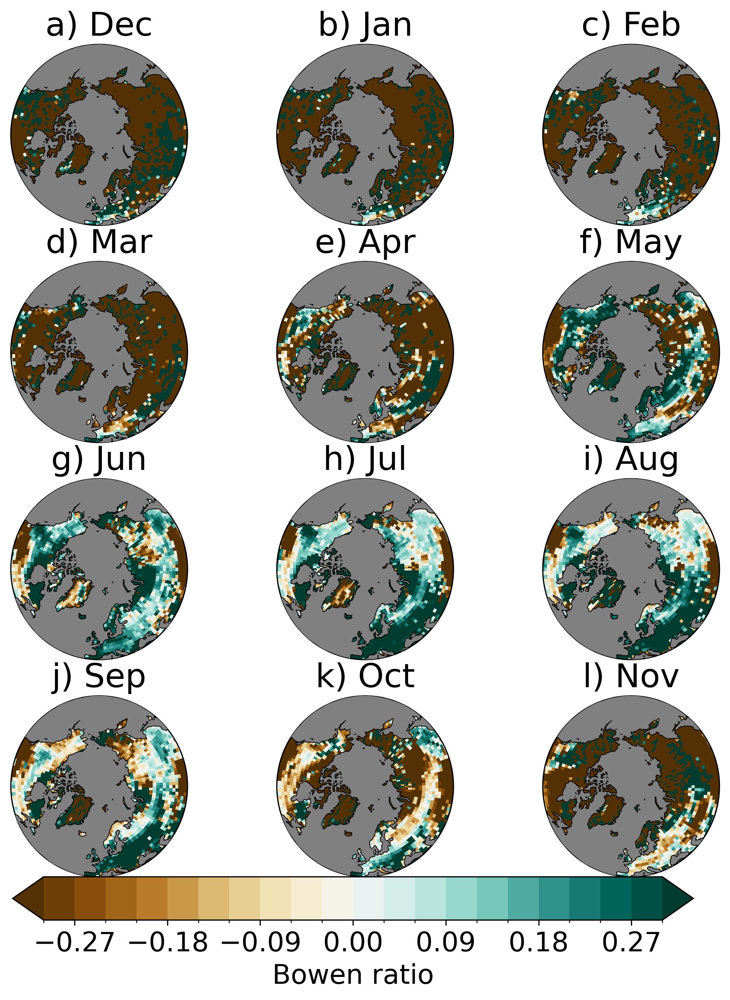

In [29]:
var = 'BOWEN_RATIO'
tslice = slice('2040-01-01', '2069-12-31')
energy_slice_piClim = energy_piClim.sel(time=tslice)
energy_slice_2xCO2 = energy_2xCO2.sel(time=tslice)
energy_slice_4xCO2 = energy_4xCO2.sel(time=tslice)
lim = 0.3
levels = np.linspace(-lim, lim, 21)
#unit = 'Evaporative fraction'
unit = 'Bowen ratio'
energy_piClim_season = energy_slice_piClim.groupby(energy_slice_piClim.time.dt.month).mean('time',skipna=True)
energy_2xCO2_season = energy_slice_2xCO2.groupby(energy_slice_2xCO2.time.dt.month).mean('time',skipna=True)
energy_4xCO2_season = energy_slice_4xCO2.groupby(energy_slice_4xCO2.time.dt.month).mean('time',skipna=True)



# Set the projection to use for plotting
fig,axs = plt.subplots(nrows=4, ncols=3, figsize=[9,10],dpi=300,  subplot_kw={'projection':ccrs.Orthographic(0, 90)})

months = [[12, 1, 2], 
        [3, 4, 5], 
        [6, 7, 8], 
        [9, 10, 11]]

month_names = [['Dec', 'Jan', 'Feb'], 
        ['Mar', 'Apr', 'May'], 
        ['Jun', 'Jul', 'Aug'], 
        ['Sep', 'Oct', 'Nov']]

labels = [['a)', 'b)', 'c)'], 
        ['d)', 'e)', 'f)'], 
        ['g)', 'h)', 'i)'], 
        ['j)', 'k)', 'l)']]

for row in range(4):
    for col in range(3):
        ax = axs[row][col]
        month = months[row][col]
        piClim_s = energy_piClim_season.sel(month=month)
        ds_s = energy_4xCO2_season.sel(month=month)

        functions.polarCentral_set_latlim([40,90], ax)
        data = ds_s[var] - piClim_s[var] 
        map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                            cmap='BrBG', levels=np.linspace(-lim, lim, 21),
                                            add_colorbar=False)
        ax.set_title(labels[row][col]+' '+month_names[row][col], fontsize=22)

        ax.coastlines()
        ax.add_feature(cartopy.feature.OCEAN, zorder=100,facecolor='grey')


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)


(0.0, 2.0)

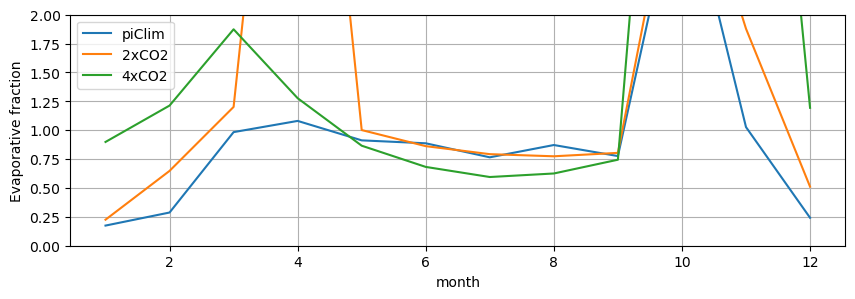

In [56]:
# PLOT EVAPORATIVE FRACTION
datadir = '/projects/NS9600K/astridbg/arctic-cld-feedbacks/data/other_cloud_vars/'
landmask = xr.open_dataarray(datadir+'LANDFRAC_piClim.nc')
landmask = landmask.isel(time=0)
oceanmask = 1-landmask

var = 'EF_abs'
#var = 'BOWEN_RATIO'
tslice = slice('2040-01-01', '2069-12-31')
energy_slice_piClim = energy_piClim.sel(time=tslice)
energy_slice_2xCO2 = energy_2xCO2.sel(time=tslice)
energy_slice_4xCO2 = energy_4xCO2.sel(time=tslice)
levels = np.linspace(-lim, lim, 21)
unit = 'Evaporative fraction'
#unit = 'Bowen ratio'

Arctic_limit = 60
Arctic_lnd_piClim = functions.computeWeightedMeanMasked(energy_slice_piClim[var].sel(lat=slice(Arctic_limit, 90), lon=slice(0,290)), landmask.sel(lat=slice(Arctic_limit, 90), lon=slice(0,290)))
Arctic_lnd_2xCO2 = functions.computeWeightedMeanMasked(energy_slice_2xCO2[var].sel(lat=slice(Arctic_limit, 90), lon=slice(0,290)), landmask.sel(lat=slice(Arctic_limit, 90), lon=slice(0,290)))
Arctic_lnd_4xCO2 = functions.computeWeightedMeanMasked(energy_slice_4xCO2[var].sel(lat=slice(Arctic_limit, 90), lon=slice(0,290)), landmask.sel(lat=slice(Arctic_limit, 90), lon=slice(0,290)))

energy_piClim_m = Arctic_lnd_piClim.groupby(Arctic_lnd_piClim.time.dt.month).mean('time',skipna=True)
energy_2xCO2_m = Arctic_lnd_2xCO2.groupby(Arctic_lnd_2xCO2.time.dt.month).mean('time',skipna=True)
energy_4xCO2_m = Arctic_lnd_4xCO2.groupby(Arctic_lnd_4xCO2.time.dt.month).mean('time',skipna=True)

fig = plt.figure(figsize=(10,3))
energy_piClim_m.plot(label='piClim')
energy_2xCO2_m.plot(label='2xCO2')
energy_4xCO2_m.plot(label='4xCO2')
plt.legend()
plt.grid()
plt.ylabel('Evaporative fraction')
plt.ylim([0,2])


Text(0.5, 0, 'mm/day')

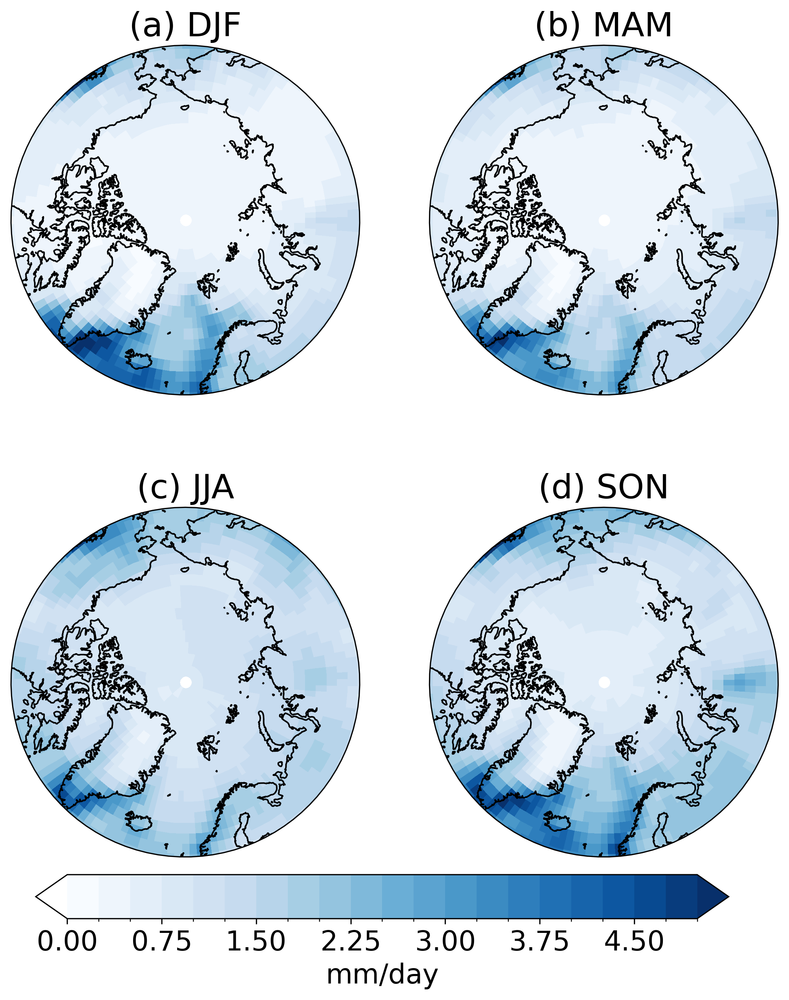

In [16]:
# PLOT ABSOLUTE PRECIPITATION
var = 'PRECL'
tslice = slice('2040-01-01', '2069-12-31')
precip_slice_piClim = precip_piClim.sel(time=tslice)
precip_slice_4xCO2 = precip_4xCO2.sel(time=tslice)
lim = 5
levels = np.linspace(0, lim, 21)
unit = 'mm/day'

precip_piClim_season = precip_slice_piClim.groupby(precip_slice_piClim.time.dt.season).mean('time')
precip_4xCO2_season = precip_slice_4xCO2.groupby(precip_slice_4xCO2.time.dt.season).mean('time')

fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):

    functions.polarCentral_set_latlim([60,90], ax)
    data = precip_piClim_season[var].sel(season=season)
    data = data*1000*60*60*24
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='Blues', levels=levels,
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)

Text(0.5, 0, '%')

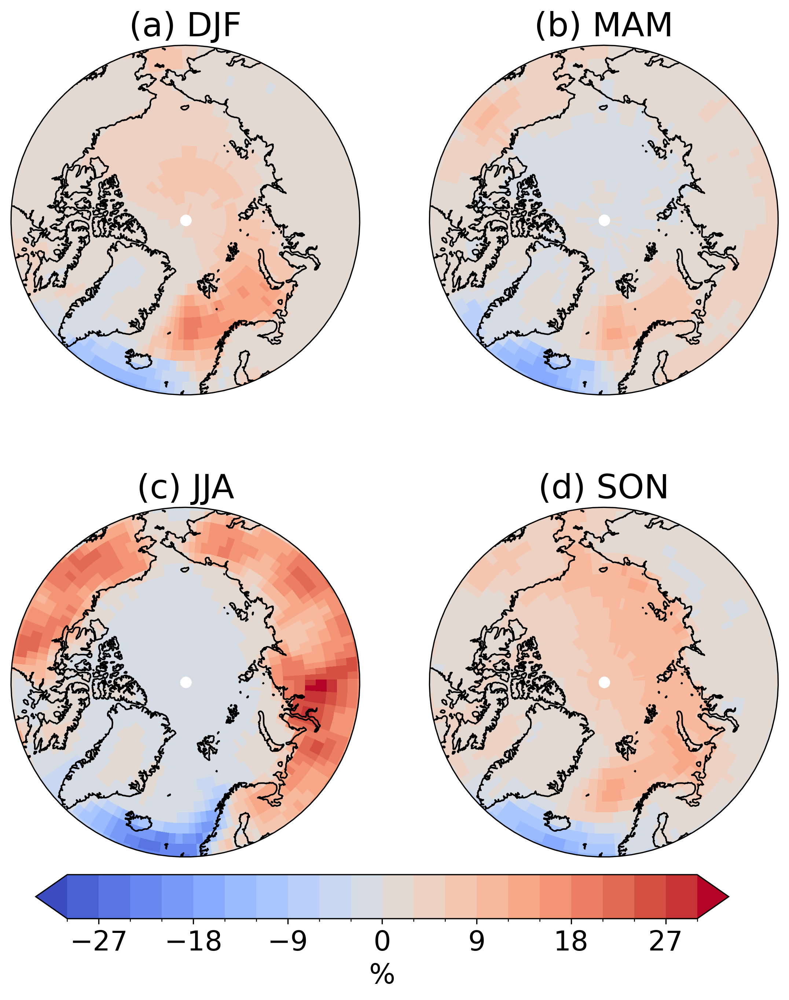

In [23]:
# PLOT PERCENTAGE OF TOTAL PRECIPITATION
var = 'PRECC'
tslice = slice('2040-01-01', '2069-12-31')
precip_slice_piClim = precip_piClim.sel(time=tslice)
precip_slice_4xCO2 = precip_4xCO2.sel(time=tslice)
lim = 30
levels = np.linspace(-lim, lim, 21)
unit = '%'

precip_piClim_season = precip_slice_piClim.groupby(precip_slice_piClim.time.dt.season).mean('time')
precip_4xCO2_season = precip_slice_4xCO2.groupby(precip_slice_4xCO2.time.dt.season).mean('time')

fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):

    functions.polarCentral_set_latlim([60,90], ax)
    data_piClim = precip_piClim_season[var].sel(season=season)/(precip_piClim_season['PRECC'].sel(season=season)+precip_piClim_season['PRECL'].sel(season=season))
    data_4xCO2 = precip_4xCO2_season[var].sel(season=season)/(precip_4xCO2_season['PRECC'].sel(season=season)+precip_4xCO2_season['PRECL'].sel(season=season))
    data = (data_4xCO2 - data_piClim)*100
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='coolwarm', levels=levels,
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)

Text(0.5, 0, 'mm/day')

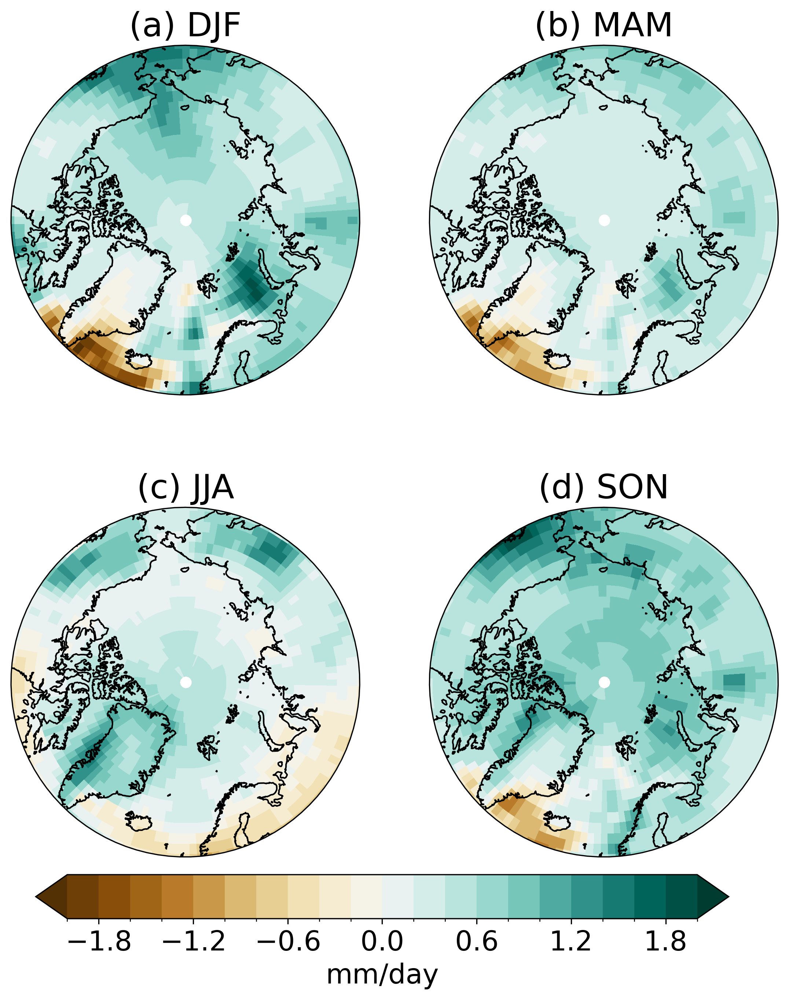

In [15]:
# PLOT TOTAL PRECIPITATION CHANGE
tslice = slice('2040-01-01', '2069-12-31')
precip_slice_piClim = precip_piClim.sel(time=tslice)
precip_slice_4xCO2 = precip_4xCO2.sel(time=tslice)
lim = 2
levels = np.linspace(-lim, lim, 21)
unit = 'mm/day'

precip_piClim_season = precip_slice_piClim.groupby(precip_slice_piClim.time.dt.season).mean('time')
precip_4xCO2_season = precip_slice_4xCO2.groupby(precip_slice_4xCO2.time.dt.season).mean('time')

fig = plt.figure(1, figsize=[9,10],dpi=300)

# Set the projection to use for plotting
ax1 = plt.subplot(2, 2, 1, projection=ccrs.Orthographic(0, 90))
ax2 = plt.subplot(2, 2, 2, projection=ccrs.Orthographic(0, 90))
ax3 = plt.subplot(2, 2, 3, projection=ccrs.Orthographic(0, 90))
ax4 = plt.subplot(2, 2, 4, projection=ccrs.Orthographic(0, 90))
#plt.subplots_adjust(top=0.85)

for ax,season,label in zip([ax1, ax2, ax3, ax4], ["DJF", "MAM","JJA","SON"], ["(a)", "(b)", "(c)", "(d)"]):

    functions.polarCentral_set_latlim([60,90], ax)
    data = precip_4xCO2_season['PRECC'].sel(season=season) + precip_4xCO2_season['PRECL'].sel(season=season)- precip_piClim_season['PRECC'].sel(season=season) - precip_piClim_season['PRECL'].sel(season=season)
    data = data*1000*60*60*24
    map = data.plot.pcolormesh(ax=ax, transform=ccrs.PlateCarree(), 
                                        cmap='BrBG', levels=levels,
                                        add_colorbar=False)
    ax.set_title(label+" "+season, fontsize=22)
    ax.coastlines()


cb_ax = fig.add_axes([0.15, 0.07, 0.7, 0.04])

cbar = plt.colorbar(map, cax=cb_ax, spacing = 'uniform', extend='both', orientation='horizontal', fraction=0.046, pad=0.06)
cbar.ax.tick_params(labelsize=18)
cbar.ax.set_xlabel(unit, fontsize=18)
